# Setup

In [5]:
#dependencies
import pandas as pd
import glob
import os

#stats
import scipy.stats as stats
from scipy.stats import linregress
from sklearn.linear_model import LinearRegression
import numpy as np

#plotting
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

#config
from config import mapbox_token

# CSVs

In [6]:
#local csv files
csv_all = [i for i in glob.glob('Resources/*.csv')]
csv_all.sort()

In [7]:
#read csv list
csv_listread = [pd.read_csv(x, low_memory=False) for x in csv_all]

In [8]:
#check list
csv_all

['Resources/MERGED1996_97_PP.csv',
 'Resources/MERGED1997_98_PP.csv',
 'Resources/MERGED1998_99_PP.csv',
 'Resources/MERGED1999_00_PP.csv',
 'Resources/MERGED2000_01_PP.csv',
 'Resources/MERGED2001_02_PP.csv',
 'Resources/MERGED2002_03_PP.csv',
 'Resources/MERGED2003_04_PP.csv',
 'Resources/MERGED2004_05_PP.csv',
 'Resources/MERGED2005_06_PP.csv',
 'Resources/MERGED2006_07_PP.csv',
 'Resources/MERGED2007_08_PP.csv',
 'Resources/MERGED2008_09_PP.csv',
 'Resources/MERGED2009_10_PP.csv',
 'Resources/MERGED2010_11_PP.csv',
 'Resources/MERGED2011_12_PP.csv',
 'Resources/MERGED2012_13_PP.csv',
 'Resources/MERGED2013_14_PP.csv',
 'Resources/MERGED2014_15_PP.csv',
 'Resources/MERGED2015_16_PP.csv',
 'Resources/MERGED2016_17_PP.csv',
 'Resources/MERGED2017_18_PP.csv']

In [9]:
#df list
df_list = [pd.DataFrame(f) for f in csv_listread]

In [10]:
#years for keys
yearlist = [x.split('_') for x in csv_all]
yearlist = [x[1] for x in yearlist]
yearlist

['97',
 '98',
 '99',
 '00',
 '01',
 '02',
 '03',
 '04',
 '05',
 '06',
 '07',
 '08',
 '09',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18']

# DataFrames

In [11]:
#concatenate dfs
df = pd.concat(df_list, keys=yearlist)

In [12]:
#show df
df

UNITID     OPEID  OPEID6  \
97 0       100636  01230800   12308   
   1       100654  00100200    1002   
   2       100663  00105200    1052   
   3       100672  00574900    5749   
   4       100690  02503400   25034   
   5       100706  00105500    1055   
   6       100724  00100500    1005   
   7       100751  00105100    1051   
   8       100760  00100700    1007   
   9       100812  00100800    1008   
   10      100830  00831000    8310   
   11      100858  00100900    1009   
   12      100919  00570400    5704   
   13      100937  00101200    1012   
   14      100964  00573301    5733   
   15      101019  02319500   23195   
   16      101028  01218200   12182   
   17      101037  00573600    5736   
   18      101073  01055400   10554   
   19      101107  00569800    5698   
   20      101116  00446300    4463   
   21      101143  00101500    1015   
   22      101161  00106000    1060   
   23      101189  00100300    1003   
   24      101198  00100301    1003   
   25      101204  00100302    1003   
   26      101213  00100303    1003   
   27      101231  00446200    4462   
   28      101240  00101700    1017   
   29      101268  00446201    4462   
...           ...       ...     ...   
18 7028  47503301   4208601   42086   
   7029  47503302   4208602   42086   
   7030  47503303   4208605   42086   
   7031  47503304   4208606   42086   
   7032  47503305   4208603   42086   
   7033  47503306   4208604   42086   
   7034  47503307   4208607   42086   
   7035  47503308   4208608   42086   
   7036  47503309   4208609   42086   
   7037  47503310   4208610   42086   
   7038  47503311   4208611   42086   
   7039  47503312   4208612   42086   
   7040  47503313   4208613   42086   
   7041  47647001   4088301   40883   
   7042  47662901   4189101   41891   
   7043  47691101   4205801   42058   
   7044  48065701    869423    8694   
   7045  48079001   4218901   42189   
   7046  48092101   4220001   42200   
   7047  48133101   4213501   42135   
   7048  48154401   4220901   42209   
   7049  48305401   4224601   42246   
   7050  48312401    108131    1081   
   7051  48312402    108161    1081   
   7052  48312403    108162    1081   
   7053  48312404    108163    1081   
   7054  48387801   4223701   42237   
   7055  48400201   4228101   42281   
   7056  48778201   4221501   42215   
   7057  49005401   4182601   41826   

                                                    INSTNM              CITY  \
97 0                    Community College of the Air Force        Montgomery   
   1                              Alabama A & M University            Normal   
   2                   University of Alabama at Birmingham        Birmingham   
   3                ALABAMA AVIATION AND TECHNICAL COLLEGE             OZARK   
   4                                    Amridge University        Montgomery   
   5                   University of Alabama in Huntsville        Huntsville   
   6                              Alabama State University        Montgomery   
   7                             The University of Alabama        Tuscaloosa   
   8                     Central Alabama Community College    Alexander City   
   9                               Athens State University            Athens   
   10                      Auburn University at Montgomery        Montgomery   
   11                                    Auburn University            Auburn   
   12       Lawson State Community College-Bessemer Campus          Bessemer   
   13                          Birmingham Southern College        Birmingham   
   14         BEVILL STATE COMMUNITY COLLEGE-BREWER CAMPUS           FAYETTE   
   15                    CHARLES ACADEMY OF BEAUTY CULTURE            MOBILE   
   16               Chattahoochee Valley Community College       Phenix City   
   17              CHAUNCEY SPARKS STATE TECHNICAL COLLEGE           EUFAULA   
   18                            Concordia College Alabama             S

In [13]:
#columns to use
cols = ['CONTROL',
        'LOCALE',
        'ST_FIPS',
        'REGION',
        'LATITUDE',
        'LONGITUDE',
        
        'AVGFACSAL',
        'ADM_RATE',
        'PREDDEG',
        'HIGHDEG',
        'CDR3',
        'SAT_AVG_ALL',
        'COSTT4_A',
        'C150_4',
        'TUITIONFEE_IN',
        'TUITIONFEE_OUT',
        'TUITFTE',
        'DEBT_MDN_SUPP',
        'MN_EARN_WNE_P6',
        'GRAD_DEBT_MDN10YR',
        'RPY_3YR_RT_SUPP',
        'PCIP54',
           
        'HBCU',
        'PBI',
        'HSI',
        'ANNHI',
        'NANTI',
        'TRIBAL',
        'AANAPII',
        'UGDS',
        'PREDDEG',
           
        'UGDS_WHITENH',
        'UGDS_BLACKNH',
        'UGDS_API',
        'UGDS_AIANOLD',
        'UGDS_HISPOLD',
        
        'UG_NRA',
        'UG_UNKN',
        'UG_WHITENH',
        'UG_BLACKNH',
        'UG_API',
        'UG_AIANOLD',
        'UG_HISPOLD',

        'UGDS_WHITE',
        'UGDS_BLACK',
        'UGDS_HISP',
        'UGDS_ASIAN',
        'UGDS_AIAN',
        'UGDS_NHPI',
        'UGDS_2MOR',
        'UGDS_UNKN',
        'UGDS_NRA']

#reset index --> move year from index to one populated column
df_all = df[cols].reset_index(level=[0]).rename(columns={'level_0':'Year'})

#show df
df_all

,Year,CONTROL,LOCALE,ST_FIPS,REGION,LATITUDE,LONGITUDE,AVGFACSAL,ADM_RATE,PREDDEG,...,UG_HISPOLD,UGDS_WHITE,UGDS_BLACK,UGDS_HISP,UGDS_ASIAN,UGDS_AIAN,UGDS_NHPI,UGDS_2MOR,UGDS_UNKN,UGDS_NRA
0,97,1.0,NaN,1.0,0.0,NaN,NaN,NaN,NaN,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,0.0000
1,97,1.0,NaN,1.0,5.0,NaN,NaN,4285.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0003,0.0423
2,97,1.0,NaN,1.0,5.0,NaN,NaN,5988.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0250,0.0230
3,97,1.0,NaN,1.0,5.0,NaN,NaN,4406.0,NaN,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,0.0407
4,97,2.0,NaN,1.0,5.0,NaN,NaN,2962.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,0.0000
5,97,1.0,NaN,1.0,5.0,NaN,NaN,5385.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,0.0327
6,97,1.0,NaN,1.0,5.0,NaN,NaN,4216.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0006,0.0062
7,97,1.0,NaN,1.0,5.0,NaN,NaN,5595.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0040,0.0295
8,97,1.0,NaN,1.0,5.0,NaN,NaN,4169.0,NaN,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0000,0.0045
9,97,1.0,NaN,1.0,5.0,NaN,NaN,5061.0,NaN,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0044,0.0000


In [14]:
#count na values
df_all['DEBT_MDN_SUPP'].isna().sum()

16742

In [15]:
#combine legacy ethnicity columns
df_all['undergrads_white'] = df_all['UGDS_WHITENH'].fillna(0) + \
    df_all['UG_WHITENH'].fillna(0) + df_all['UGDS_WHITE'].fillna(0)
    
df_all['undergrads_black'] = df_all['UGDS_BLACKNH'].fillna(0) + \
    df_all['UG_BLACKNH'].fillna(0) + df_all['UGDS_BLACK'].fillna(0)
    
df_all['undergrads_hisp'] = df_all['UGDS_HISP'].fillna(0) + \
    df_all['UG_HISPOLD'].fillna(0) + df_all['UGDS_HISPOLD'].fillna(0)

# Minority Serving Schools

In [16]:
#minority df
df_minority = df_all[cols].loc[(df_all['HBCU']==1) | (df_all['PBI']==1) | 
                       (df_all['HSI']==1) |
                       (df_all['TRIBAL']==1) | (df_all['ANNHI']==1) | (df_all['NANTI']==1) |
                       (df_all['AANAPII']==1)].copy()


df_minority = df_minority[['SAT_AVG_ALL', 'CDR3', 'COSTT4_A', 'TUITFTE', 'AVGFACSAL',
                           'HBCU','PBI', 'HSI','ANNHI','NANTI','TRIBAL','AANAPII',
                          'CONTROL','ST_FIPS','REGION']]

#transform column to category
df_minority["HBCU"] = ["HBCU" if ele  == 1 else '' for ele in df_minority["HBCU"]]
df_minority["PBI"] = ["PBI" if ele  == 1 else '' for ele in df_minority["PBI"]]
df_minority["HSI"] = ["HSI" if ele  == 1 else '' for ele in df_minority["HSI"]]
df_minority["ANNHI"] = ["ANNHI" if ele  == 1 else '' for ele in df_minority["ANNHI"]]
df_minority["NANTI"] = ["NANTI" if ele  == 1 else '' for ele in df_minority["NANTI"]]
df_minority["TRIBAL"] = ["TRIBAL" if ele  == 1 else '' for ele in df_minority["TRIBAL"]]
df_minority["AANAPII"] = ["AANAPII" if ele  == 1 else '' for ele in df_minority["AANAPII"]]

#combine columns
df_minority['Minority_Serving'] = df_minority['HBCU'].astype(str).str.cat(df_minority[['PBI', 'HSI', 'ANNHI', 'NANTI',
                                                                           'TRIBAL','AANAPII']].astype(str))

#rename cols
df_minority = df_minority.rename(columns={'REGION':'Region', 'SAT_AVG_ALL':'SAT_avg','CDR3':'Default_rate',
                                          'COSTT4_A':'Cost_attendance','TUITFTE':'Tuition_revenue', 
                                          'CONTROL':'Control', 'ST_FIPS':'State'})
#drop na
df_minority.dropna(inplace=True)
df_minority

,SAT_avg,Default_rate,Cost_attendance,Tuition_revenue,AVGFACSAL,HBCU,PBI,HSI,ANNHI,NANTI,TRIBAL,AANAPII,Control,State,Region,Minority_Serving
0,929.0,0.198,22886.0,9227.0,6983.0,HBCU,,,,,,,1.0,1.0,5.0,HBCU
4,935.0,0.211,19413.0,9003.0,7399.0,HBCU,,,,,,,1.0,1.0,5.0,HBCU
16,1031.0,0.122,31720.0,11037.0,5702.0,,PBI,,,,,,2.0,1.0,5.0,PBI
33,1041.0,0.078,19671.0,8192.0,6711.0,,PBI,,,,,,1.0,1.0,5.0,PBI
42,1005.0,0.137,35577.0,12014.0,4902.0,HBCU,,,,,,,2.0,1.0,5.0,HBCU
56,1036.0,0.115,36673.0,15268.0,4753.0,HBCU,,,,,,,2.0,1.0,5.0,HBCU
61,1094.0,0.122,17168.0,7960.0,9617.0,,,,ANNHI,,,,1.0,2.0,8.0,ANNHI
127,951.0,0.141,16264.0,3002.0,5851.0,HBCU,,,,,,,1.0,5.0,5.0,HBCU
196,1131.0,0.034,49911.0,18252.0,8201.0,,,,,,,AANAPII,2.0,6.0,8.0,AANAPII
218,1129.0,0.037,21137.0,4875.0,10273.0,,,,,,,AANAPII,1.0,6.0,8.0,AANAPII


In [17]:
#scatter plot--minority serving schools: SAT vs.Default Rate
scatter = px.scatter(df_minority, x='SAT_avg', y='Default_rate', marginal_x = 'histogram',
                     size='Cost_attendance', size_max = 25, color='Minority_Serving', hover_name='Minority_Serving',
                     title = 'Minority Serving Schools: SAT average v. Default Rate',
                    labels = {'SAT_avg':'SAT Average', 'Default_rate':'Default Rate'})

#center title
scatter.update(layout=dict(title=dict(x=0.15)))

#save w/ Orca
scatter.write_image('Resources/minority_SAT_default.png')

#show
scatter.show()

In [18]:
#3d scatter plot--minority serving schools: 

regions = ['New England', 'Mid East', 'Great Lakes', 'Plains', 
           'Southeast', 'Southwest', 'Rocky Mountains', 'Far West', 'Outlying Areas']

#draw figure
fig = px.scatter_3d(df_minority, x="AVGFACSAL", y="SAT_avg", z='Default_rate', color='Region',
                   labels = {'Default_rate':'3 yr default rate', 'SAT_avg':'SAT avg.', 
                             'AVGFACSAL':'Avg Faculty Salary'},
                   title = 'Minority Serving Institutions: Faculty Salary / SAT / Default Rate')

fig.update(layout=dict(title=dict(x=0.5)))

#show
fig.show()

# Debt

In [19]:
#new df for black debt
df_black_debt = df_all[['undergrads_black','undergrads_white','undergrads_hisp','UGDS_ASIAN',
                        'DEBT_MDN_SUPP', 'REGION', 'COSTT4_A', 'CDR3',
                        'TUITFTE', 'Year','CONTROL','ST_FIPS']].copy()

#drop na
df_black_debt.dropna(inplace=True)

#rename cols
df_black_debt = df_black_debt.rename(columns={'DEBT_MDN_SUPP':'Median_debt', 'REGION':'Region', 'COSTT4_A':'Cost_attendance',
                                              'TUITFTE':'Tuition_revenue', 'CONTROL':'Control', 'ST_FIPS':'State'})

#drop suppressed values
df_black_debt = df_black_debt[df_black_debt['Median_debt'] != 'PrivacySuppressed']

#show
df_black_debt.describe()

,undergrads_black,undergrads_white,undergrads_hisp,UGDS_ASIAN,Region,Cost_attendance,CDR3,Tuition_revenue,Control,State
count,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000,21912.000000
mean,0.173683,0.545176,0.130485,0.034463,4.473394,25381.280622,0.131313,10381.927163,1.856106,29.673375
std,0.205162,0.257136,0.178497,0.056051,2.103485,12761.792575,0.083108,7535.046073,0.799094,16.200142
min,0.000000,0.000000,0.000000,0.000000,0.000000,2200.000000,0.000000,0.000000,1.000000,1.000000
25%,0.040600,0.359175,0.030200,0.006700,3.000000,14756.750000,0.060000,3870.000000,1.000000,17.000000
50%,0.092400,0.598800,0.064500,0.015400,5.000000,23434.000000,0.122000,9769.500000,2.000000,29.000000
75%,0.224400,0.755400,0.147725,0.036100,6.000000,31761.000000,0.190000,14929.250000,3.000000,42.000000
max,1.000000,1.000000,1.000000,0.778400,9.000000,91532.000000,1.000000,147403.000000,3.000000,78.000000


In [20]:
#animated scatter, black undergrads
fig = px.scatter(df_black_debt, x="undergrads_black", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=20,
                labels = {'undergrads_black': '% Black Undergrads', 
                        'CDR3':'3 Year Default Rate', 'Region':'Region'},
                animation_frame='Year',
                title='% Black Undergrads / Default Rate', trendline='lowess', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

#fig.write_image("Resources/black_default.svg")

fig.show()

In [21]:
#animated scatter, white undergrads
fig = px.scatter(df_black_debt, x="undergrads_white", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=20,
                labels = {'undergrads_white': '% White Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% White Undergrads / Default Rate', trendline='lowess', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/white_default.svg")

fig.show()

In [22]:
#animated scatter, hispanic undergrads
fig = px.scatter(df_black_debt, x="undergrads_hisp", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=20,
                labels = {'undergrads_hisp': '% Hispanic Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                title='% Hispanic Undergrads / Default Rate', trendline='lowess', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/hisp_default.svg")

fig.show()

In [23]:
#animated scatter, asian undergrads
fig = px.scatter(df_black_debt, x="UGDS_ASIAN", y='CDR3', 
                color='Region', size='Cost_attendance', size_max=20,
                labels = {'UGDS_ASIAN': '% Asian Undergrads', 
                        'CDR3':'3 Year Default Rate'},
                animation_frame='Year',
                range_x = (0,1),
                title='% Asian Undergrads / Default Rate', trendline='lowess', trendline_color_override="#FFFAF0")

fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image("Resources/asian_default.svg")

fig.show()

# Public / Private Schools

In [24]:
df_monetary = df_all[['undergrads_black','undergrads_white','undergrads_hisp','UGDS_ASIAN',
                      'AVGFACSAL','PREDDEG','CONTROL','Year','CDR3','C150_4','PCIP54','TUITFTE','REGION','COSTT4_A']].copy()
df_monetary.dropna(inplace=True)
df_monetary.head()

,undergrads_black,undergrads_white,undergrads_hisp,UGDS_ASIAN,AVGFACSAL,PREDDEG,PREDDEG,CONTROL,Year,CDR3,C150_4,PCIP54,TUITFTE,REGION,COSTT4_A
0,0.9572,0.0263,0.0039,0.0017,6460.0,3,3,1.0,12,0.143,0.3171,0.0000,4626.0,5.0,14965.0
1,0.2684,0.5960,0.0220,0.0446,9420.0,3,3,1.0,12,0.059,0.4462,0.0293,7289.0,5.0,19547.0
2,0.1778,0.1806,0.0250,0.0000,3500.0,3,3,2.0,12,0.107,0.2500,0.0000,11969.0,5.0,11540.0
3,0.1444,0.7117,0.0276,0.0346,8482.0,3,3,1.0,12,0.067,0.4537,0.0136,7264.0,5.0,19072.0
4,0.9555,0.0106,0.0070,0.0008,6794.0,3,3,1.0,12,0.210,0.2621,0.0018,7220.0,5.0,15986.0


In [25]:
df_monetary_public = df_monetary.loc[df_monetary['CONTROL']==1].copy()
df_monetary_forprofit = df_monetary.loc[df_monetary['CONTROL']==3].copy()

In [26]:
fig = px.scatter_3d(df_monetary_forprofit, x="undergrads_black", y="TUITFTE", z='C150_4', color='REGION',
                   labels = {'C150_4':'Compl. Rate (150% time)', 'UGDS_Black':'% Black Students','TUITFTE':'Tuition Revenue (Net)'},
                   range_y = (0, 50000), animation_frame='Year', animation_group='CONTROL',
                   title = 'Private For Profits: % Black Students / Tuition Revenue / Compl. Rate')

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

In [27]:
fig = px.scatter(df_monetary_forprofit, x="undergrads_black", y='C150_4', color='REGION', size='TUITFTE', size_max=150,
                   labels = {'C150_4':'Compl. Rate (150% time)', 'undergrads_black':'% Black Students'},
                   animation_frame='Year', animation_group='REGION',
                   title='Private For Profits: % Black Students / Compl. Rate')

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

In [28]:
df_monetary.head()

,undergrads_black,undergrads_white,undergrads_hisp,UGDS_ASIAN,AVGFACSAL,PREDDEG,PREDDEG,CONTROL,Year,CDR3,C150_4,PCIP54,TUITFTE,REGION,COSTT4_A
0,0.9572,0.0263,0.0039,0.0017,6460.0,3,3,1.0,12,0.143,0.3171,0.0000,4626.0,5.0,14965.0
1,0.2684,0.5960,0.0220,0.0446,9420.0,3,3,1.0,12,0.059,0.4462,0.0293,7289.0,5.0,19547.0
2,0.1778,0.1806,0.0250,0.0000,3500.0,3,3,2.0,12,0.107,0.2500,0.0000,11969.0,5.0,11540.0
3,0.1444,0.7117,0.0276,0.0346,8482.0,3,3,1.0,12,0.067,0.4537,0.0136,7264.0,5.0,19072.0
4,0.9555,0.0106,0.0070,0.0008,6794.0,3,3,1.0,12,0.210,0.2621,0.0018,7220.0,5.0,15986.0


In [56]:
#blk ugds / completion rate scatter plot
fig = px.scatter(df_monetary_public, x="undergrads_black", y="C150_4", marginal_y="histogram", marginal_x="histogram", 
                 color='REGION', labels= {'C150_4':'Completion Rate (150%)'},
                 title='Public Instiutions: Proportion Black Undergrads / Completion Rate', trendline='lowess',
                animation_frame='Year')

#----------linreg---------------

#line data
x_blk_comp = np.array(df_monetary_public['undergrads_black'].tolist())
y_blk_comp = np.array(df_monetary_public['C150_4'].tolist())

#line
(slope, intercept, r, p, stderr) = linregress(x_blk_comp, y_blk_comp)
fit_comp_cdr = slope * x_blk_comp + intercept
linregress(x_blk_comp,y_blk_comp)
rsq_blk_comp = r**2

#add line
fig.add_trace(
    go.Scatter(
        x=x_blk_comp,
        y=fit_comp_cdr,
        mode="lines",
        line=go.scatter.Line(color="yellow"),
        showlegend=False))

#----------ftest---------------
group1 = df_monetary_public[df_monetary_public["REGION"] == 0]["undergrads_black"]
group2 = df_monetary_public[df_monetary_public["REGION"] == 1]["undergrads_black"]
group3 = df_monetary_public[df_monetary_public["REGION"] == 2]["undergrads_black"]
group4 = df_monetary_public[df_monetary_public["REGION"] == 3]["undergrads_black"]
group5 = df_monetary_public[df_monetary_public["REGION"] == 4]["undergrads_black"]
group6 = df_monetary_public[df_monetary_public["REGION"] == 5]["undergrads_black"]
group7 = df_monetary_public[df_monetary_public["REGION"] == 6]["undergrads_black"]
group8 = df_monetary_public[df_monetary_public["REGION"] == 7]["undergrads_black"]
group9 = df_monetary_public[df_monetary_public["REGION"] == 8]["undergrads_black"]
group10 = df_monetary_public[df_monetary_public["REGION"] == 9]["undergrads_black"]

f_blk_comp = stats.f_oneway(group1, group2, group3, group4, group5)
print(fit_comp_cdr)

#annotation
fig.update_layout(
    showlegend=False,
    annotations=[
        go.layout.Annotation(
            showarrow=False,
            x=0.8,
            y=0.8,
            text=(f'r^2={rsq_blk_comp}')),
        go.layout.Annotation(
            showarrow=False,
            x=.8,
            y=.7,
            text=(f'f-val (blk-ugds/region)={f_blk_comp[0]}'),)
    ]
)


#center title
fig.update(layout=dict(title=dict(x=0.5)))

fig.write_image('Resources/public_blk_comp.png')

#show
fig.show()

[0.21995219 0.41876942 0.45456114 ... 0.37379886 0.43484683 0.46798304]


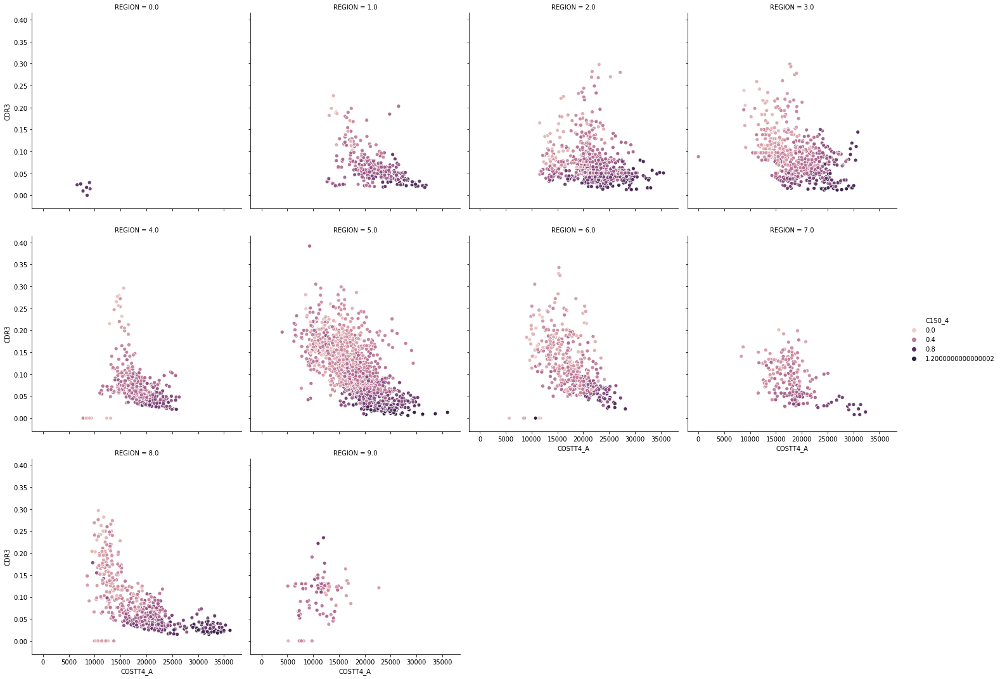

In [26]:
fig = sns.relplot(x='COSTT4_A', y='CDR3', kind='scatter', aspect=1,
               col='REGION', col_wrap= 4, data=df_monetary_public, hue='C150_4')

fig.title = ('test')

fig.savefig('Resources/public_cost_default_years.png')

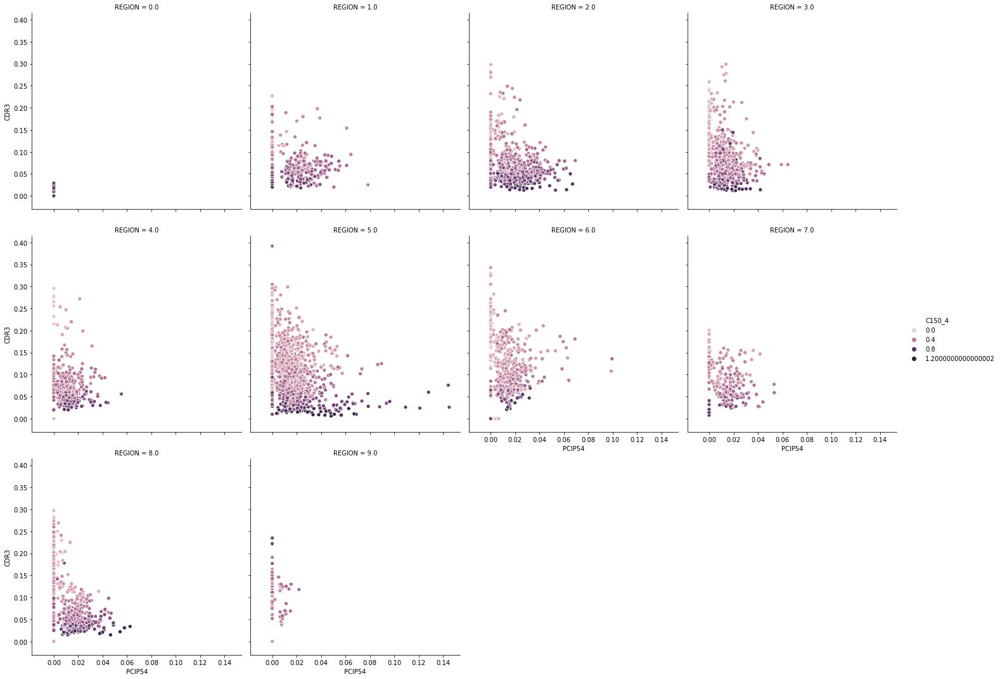

In [27]:
fig = sns.relplot(x='PCIP54', y='CDR3', kind='scatter', aspect=1,
               col='REGION', col_wrap= 4, data=df_monetary_public, hue='C150_4')

fig.title = ('test')

fig.savefig('Resources/public_historymajors_default_years.png')

# SAT Heat Scatter Map

In [130]:
#sat df
df_sat = df.copy()

#columns, reset index, drop nan
cols_sat = ['LATITUDE','LONGITUDE','SAT_AVG', 'Year', 'CDR3']
df_sat = df_sat.reset_index(level=[0]).rename(columns={'level_0':'Year'})
df_sat = df_sat[cols_sat]
df_sat.dropna(inplace=True)

df_sat.head()

,LATITUDE,LONGITUDE,SAT_AVG,Year,CDR3
0,34.783368,-86.568502,929.0,18,0.198
1,33.505697,-86.799345,1195.0,18,0.059
3,34.724557,-86.640449,1322.0,18,0.074
4,32.364317,-86.295677,935.0,18,0.211
5,33.211875,-87.545978,1278.0,18,0.052


In [101]:
px.set_mapbox_access_token(mapbox_token)

fig = px.scatter_mapbox(df_sat, lat='LATITUDE', lon='LONGITUDE', color='SAT_AVG', zoom=2.75,
                        title='SAT avg. Heat Scatter',
                        color_continuous_scale=px.colors.sequential.thermal)

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()

# CDR Heat Scatter Map

In [123]:
#cdr df
df_cdr = df.copy()

#columns, reset index, drop nan
cols_cdr = ['LATITUDE','LONGITUDE','CDR3', 'Year','UGDS_BLACK']
df_cdr = df_cdr.reset_index(level=[0]).rename(columns={'level_0':'Year'})
df_cdr = df_cdr[cols_cdr]
df_cdr.dropna(inplace=True)

df_cdr.head()

,LATITUDE,LONGITUDE,CDR3,Year,UGDS_BLACK
0,34.783368,-86.568502,0.198,18,0.9073
1,33.505697,-86.799345,0.059,18,0.2585
2,32.362609,-86.174010,0.128,18,0.1429
3,34.724557,-86.640449,0.074,18,0.1073
4,32.364317,-86.295677,0.211,18,0.9379


In [113]:
px.set_mapbox_access_token(mapbox_token)

fig = px.scatter_mapbox(df_cdr, lat='LATITUDE', lon='LONGITUDE', color='CDR3', zoom=2.75,
                        title='3yr. Default Rate Heat Scatter',
                        color_continuous_scale=px.colors.colorbrewer.Reds)

fig.update(layout=dict(title=dict(x=0.5)))

fig.show()